In [1]:
import sys, os
sys.path.insert(0, os.path.join(os.path.abspath('..'), 'src'))

In [2]:
save_folder = r'equilibrium-state-flow-calculations-anisotropic'
if not os.path.isdir(save_folder):
    os.makedirs(save_folder)

In [3]:
data_folder = r'data-from-cody'

In [4]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import pandas as pd

import FiniteDifference as fd
import LiquidCrystalHelper as lch
import biharm as bh

import time
from importlib import reload

In [5]:
reload(lch)

<module 'LiquidCrystalHelper' from 'C:\\Users\\lucas\\Documents\\Grad Work\\Summer Research 2020\\LiquidCrystalHydrodynamics\\src\\LiquidCrystalHelper.py'>

In [66]:
%matplotlib inline
dpi = 700
mpl.rcParams['figure.dpi'] = dpi

In [67]:
l = 10
n = 257

x = np.linspace(-l, l, num=n)
y = np.linspace(-l, l, num=n)
X, Y = np.meshgrid(x, y, indexing='ij')

dx = x[1] - x[0]

In [68]:
eta_filename = os.path.join(data_folder, "eta_Iso.csv")
eta = np.genfromtxt(eta_filename, delimiter=',')

mu_filename = os.path.join(data_folder, "mu_Iso.csv")
mu = np.genfromtxt(mu_filename, delimiter=',')

nu_filename = os.path.join(data_folder, "nu_Iso.csv")
nu = np.genfromtxt(nu_filename, delimiter=',')

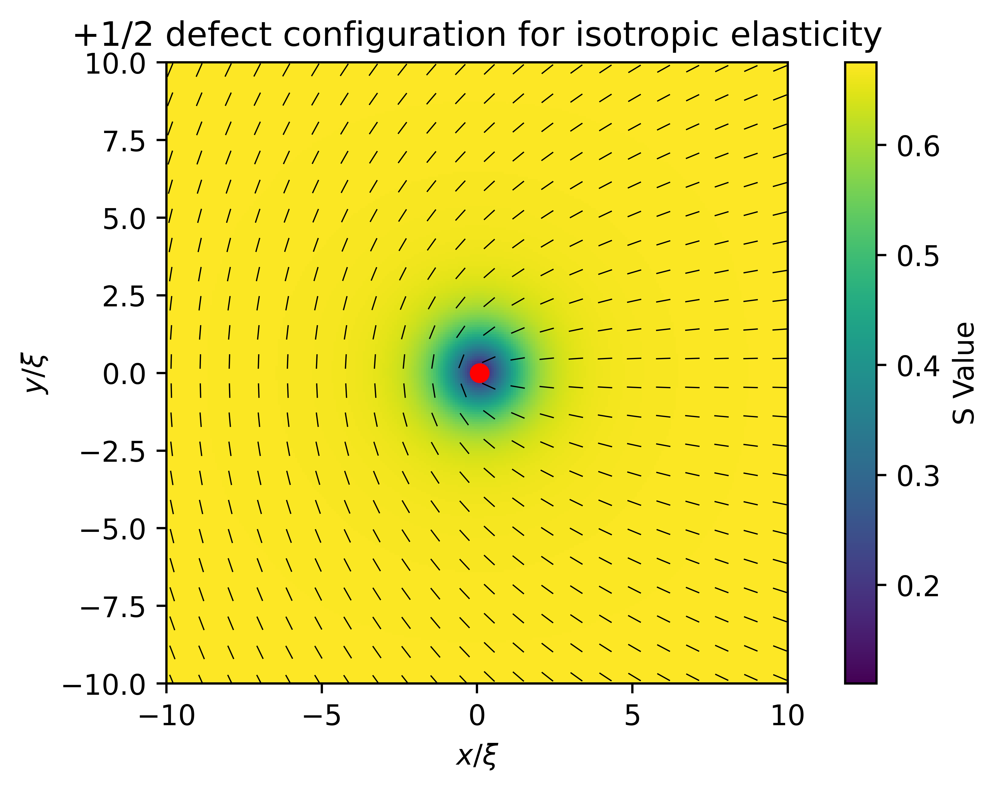

In [69]:
num_defects = 1

sparse_shape = (20, 20)
S_sparse_shape = (257, 257)
S_cutoff = 0.1

lambda_max = lch.calcQEigenvals(eta, mu, nu)
U, V = lch.calcQEigenvecs(eta, mu, nu, lambda_max, S_cutoff)

min_vals, min_x, min_y = lch.findDefects(lambda_max, X, Y, num_defects)

sparse_idx = lch.sparseIdx(eta.shape, sparse_shape)
S_sparse_idx = lch.sparseIdx(eta.shape, S_sparse_shape)

fig, ax = plt.subplots()
c = ax.pcolor(X[S_sparse_idx], Y[S_sparse_idx], (3/2)*lambda_max[S_sparse_idx])
q = ax.quiver(X[sparse_idx], Y[sparse_idx], U[sparse_idx], V[sparse_idx],
              headwidth=0, pivot='middle', headaxislength=5, scale=30, width=0.002)
ax.plot(min_x, min_y, marker='o', c='r')

fig.colorbar(c, ax=ax, label="S Value")
ax.set_title("+1/2 defect configuration for isotropic elasticity")
ax.set_xlabel(r"$x/\xi$")
ax.set_ylabel(r"$y/\xi$")
ax.set_aspect('equal', 'box')
fig.tight_layout()

config_filename = os.path.join(save_folder, r'iso-configuration.png')
fig.savefig(config_filename)

In [70]:
L = [2*l, 2*l]
shape = [n - 1, n - 1]
alpha = 0
maxiter = 500

bh_solver = bh.Biharm(L, shape, alpha, cg_maxiter=maxiter)

# Plot the isotropic elastic forces

### Calculate various contour integrals

In [71]:
def contourIntegral(fe_x, fe_y, dx, r, X, Y, min_x, min_y):
    r_arg = np.ceil(r*(n / (2*l))).astype(np.int)
    min_x_arg = np.argwhere(X[:, 0] == min_x)[0][0]
    min_y_arg = np.argwhere(Y[0, :] == min_y)[0][0]

    xlims = (min_x_arg - r_arg, min_x_arg + r_arg)
    ylims = (min_y_arg - r_arg, min_y_arg + r_arg)

    # Calculate each of the sides separately, starting at lower left corner
    I1 = (fe_x[xlims[0] + 1:xlims[1]  + 1, ylims[0]] + fe_x[xlims[0]:xlims[1], ylims[0]])*dx/2
    I2 = (fe_y[xlims[1], ylims[0]:ylims[1]] + fe_y[xlims[1], ylims[0] + 1:ylims[1] + 1])*dx/2
    I3 = -(fe_x[xlims[0] + 1:xlims[1]  + 1, ylims[1]] + fe_x[xlims[0]:xlims[1], ylims[1]])*dx/2
    I4 = -(fe_y[xlims[0], ylims[0]:ylims[1]] + fe_y[xlims[0], ylims[0] + 1:ylims[1] + 1])*dx/2
    
    cont_int = np.sum(I1 + I2 + I3 + I4)
    path_x = X[np.array([xlims[0], xlims[1], xlims[1], xlims[0], xlims[0]]), 0]
    path_y = Y[0, np.array([ylims[0], ylims[0], ylims[1], ylims[1], ylims[0]])]
    
    return cont_int, path_x, path_y

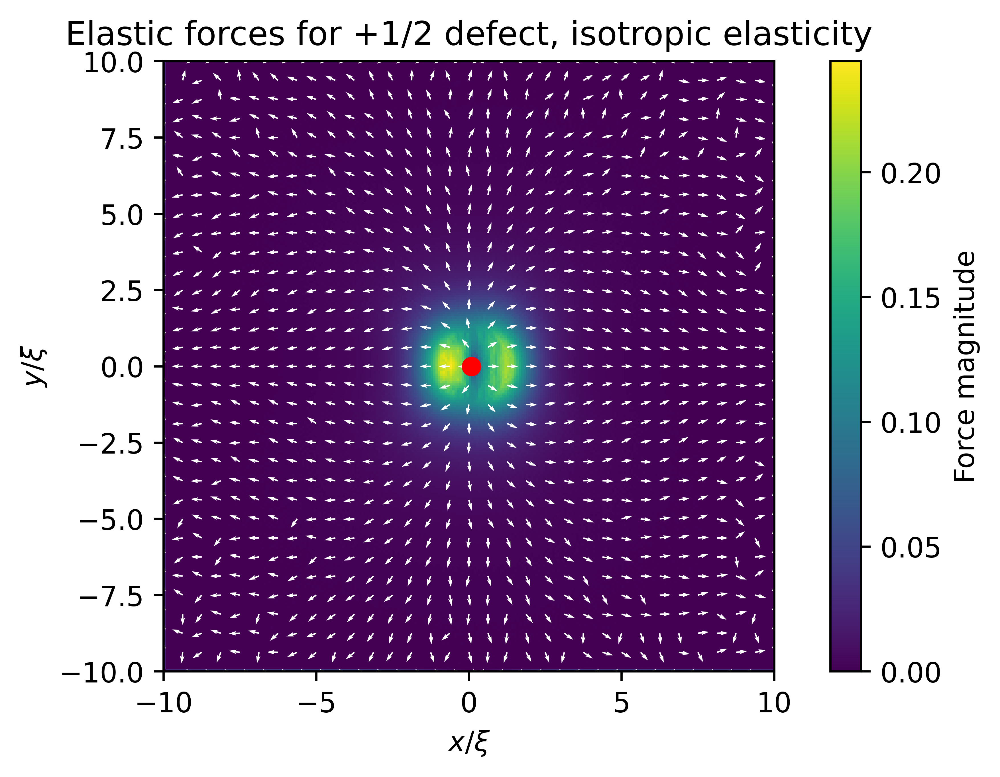

In [72]:
kappa_2 = 0
kappa_3 = 0

fe_x, fe_y = ( lch.fL1(eta, mu, nu, dx) 
              + kappa_2*lch.fL2(eta, mu, nu, dx)
              + kappa_3*lch.fL3(eta, mu, nu, dx)
              )

fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

sparse_idx = lch.sparseIdx(fe_x.shape, (30, 30))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm[sparse_idx], fe_y_norm[sparse_idx], pivot='tail', color='w', scale=55)

ax.set_title('Elastic forces for +1/2 defect, isotropic elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-isotropic-elasticity-unzoomed.png')
fig.savefig(filename_force_field)

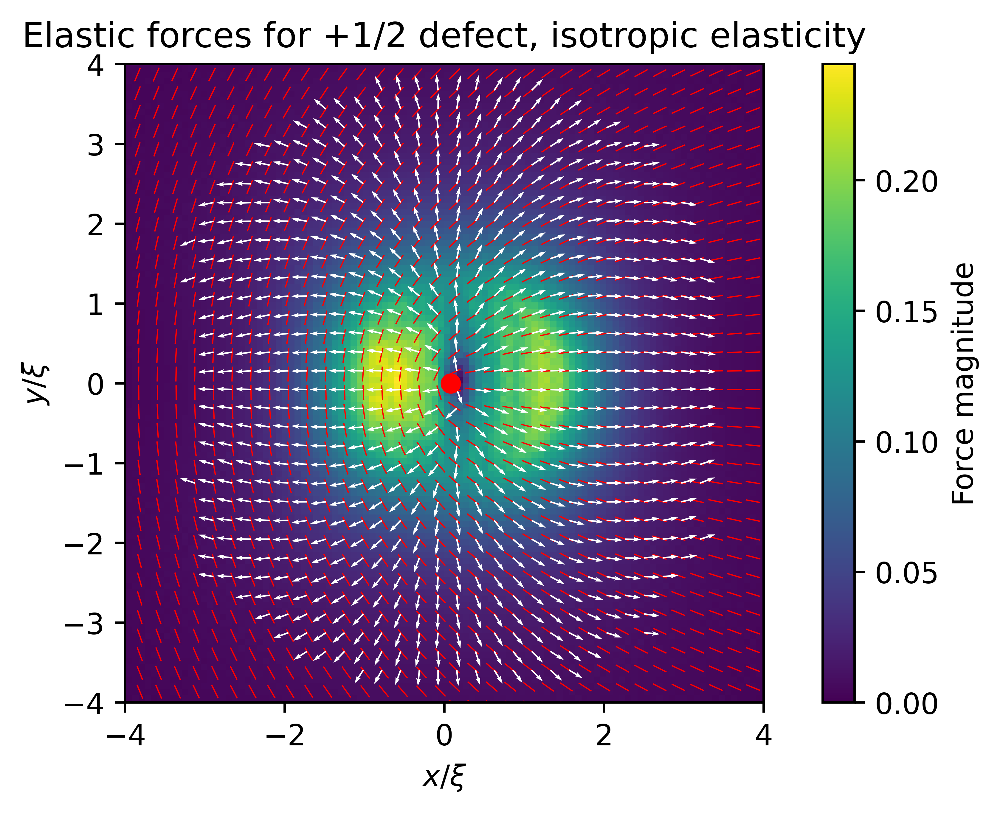

In [73]:
fe_x, fe_y = ( lch.fL1(eta, mu, nu, dx) 
              + kappa_2*lch.fL2(eta, mu, nu, dx)
              + kappa_3*lch.fL3(eta, mu, nu, dx)
              )

fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

mask2 = fe < 0.01
fe_x_norm_m = np.ma.masked_array(fe_x_norm, mask2)
fe_y_norm_m = np.ma.masked_array(fe_y_norm, mask2)

sparse_idx = lch.sparseIdx(fe_x.shape, (75, 75))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q1 = ax.quiver(X[sparse_idx], Y[sparse_idx], U[sparse_idx], V[sparse_idx],
               headwidth=0, pivot='middle', headaxislength=5, scale=30, width=0.002, color='r')
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm_m[sparse_idx], fe_y_norm_m[sparse_idx], pivot='tail', color='w', scale=40)
ax.set_title('Elastic forces for +1/2 defect, isotropic elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-isotropic-elasticity-nematic-overlayed.png')
fig.savefig(filename_force_field)

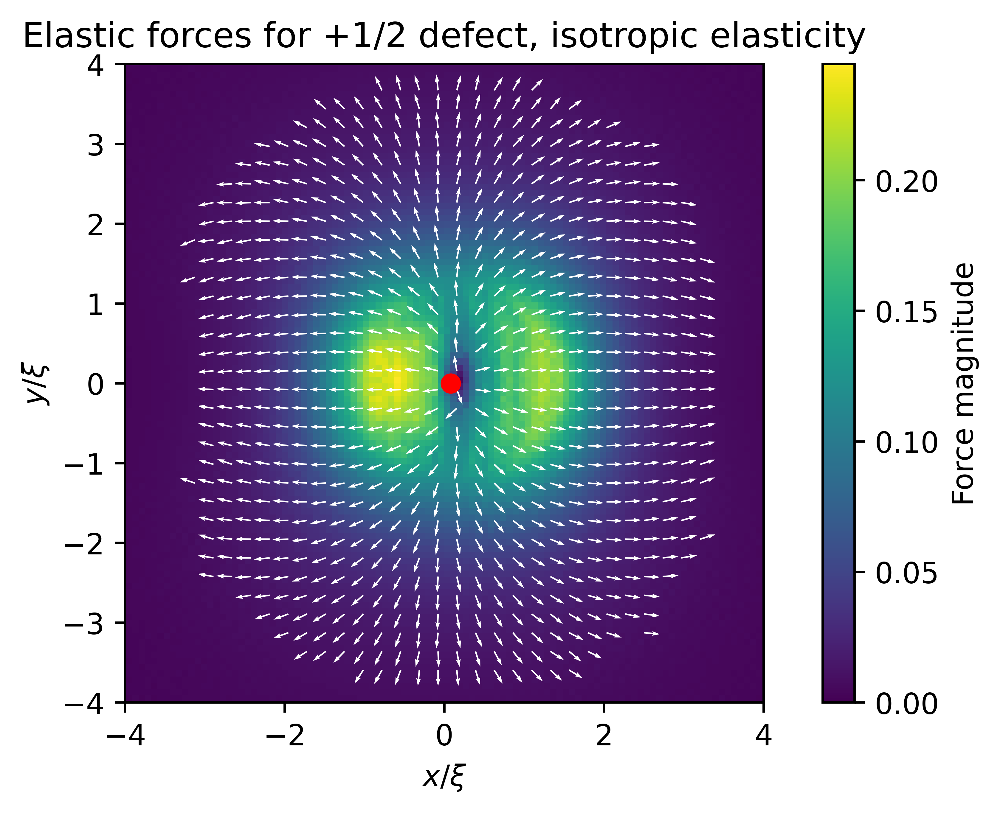

In [74]:
fe_x, fe_y = ( lch.fL1(eta, mu, nu, dx) 
              + kappa_2*lch.fL2(eta, mu, nu, dx)
              + kappa_3*lch.fL3(eta, mu, nu, dx)
              )

fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

mask2 = fe < 0.01
fe_x_norm_m = np.ma.masked_array(fe_x_norm, mask2)
fe_y_norm_m = np.ma.masked_array(fe_y_norm, mask2)

sparse_idx = lch.sparseIdx(fe_x.shape, (75, 75))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm_m[sparse_idx], fe_y_norm_m[sparse_idx], pivot='tail', color='w', scale=40)

ax.set_title('Elastic forces for +1/2 defect, isotropic elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-isotropic-elasticity.png')
fig.savefig(filename_force_field)

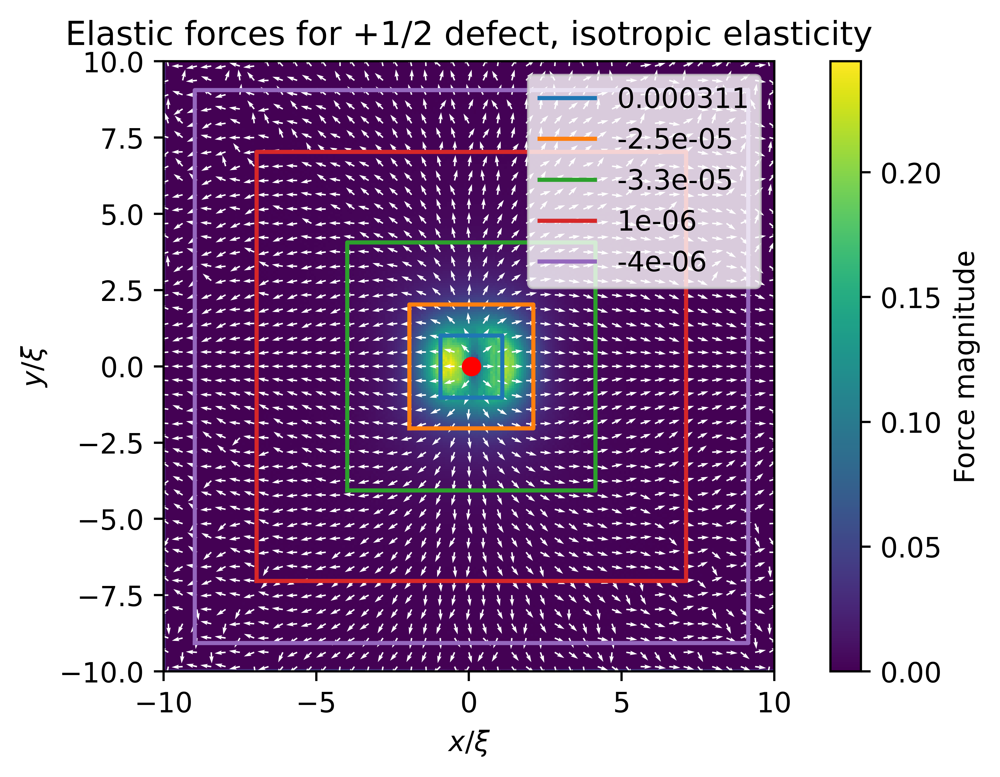

In [75]:
fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

sparse_idx = lch.sparseIdx(fe_x.shape, (40, 40))

fig, ax = plt.subplots()
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm[sparse_idx], fe_y_norm[sparse_idx], pivot='tail', color='w', scale=55)

r_array = [1, 2, 4, 7, 9]
ax.plot(min_x, min_y, marker='o', c='r')
for r in r_array:
    I, path_x, path_y = contourIntegral(fe_x, fe_y, dx, r, X, Y, min_x, min_y)
    norm_I = I/(4*r**2)
    ax.plot(path_x, path_y, label=norm_I.round(6))
ax.legend()

ax.set_title('Elastic forces for +1/2 defect, isotropic elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-isotropic-elasticity-contours.png')
fig.savefig(filename_force_field)

In [76]:
psi = np.zeros(eta.shape)
source_term = (4 / lch.b)*(lch.Phi_L1(eta, mu, nu, dx)
                           + kappa_2*lch.Phi_L2(eta, mu, nu, dx)
                           + kappa_3*lch.Phi_L3(eta, mu, nu, dx)
                           )
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

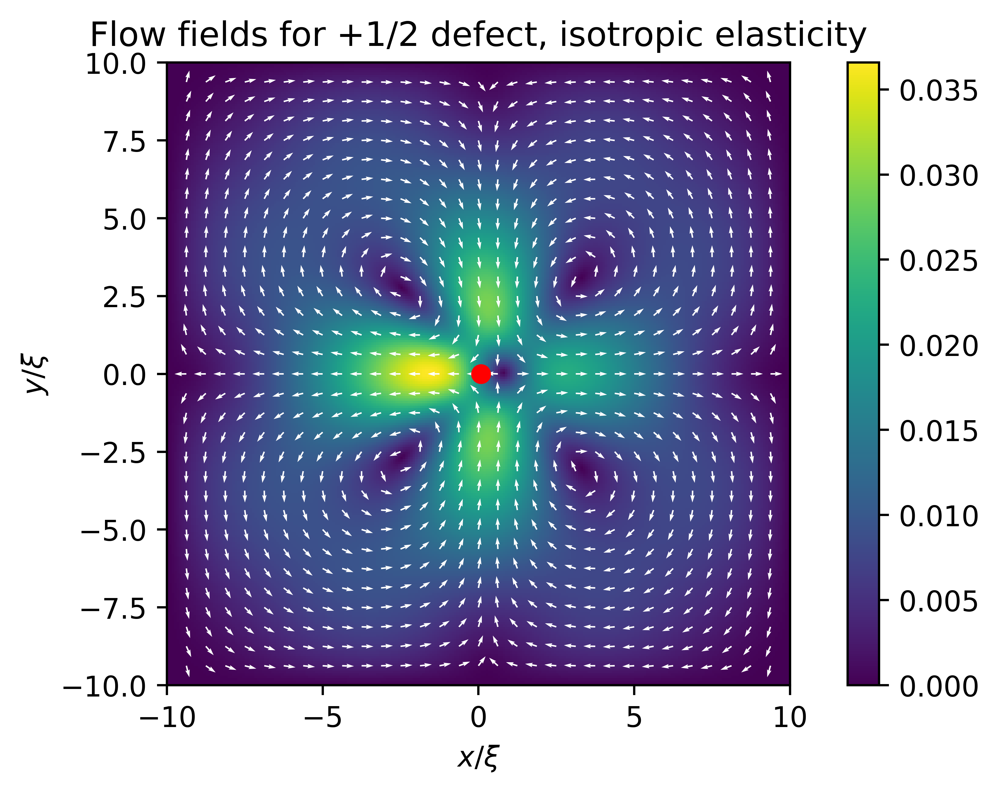

In [77]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (30, 30))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title('Flow fields for +1/2 defect, isotropic elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-isotropic-elasticity.png')
fig.savefig(filename_stress_tensor)

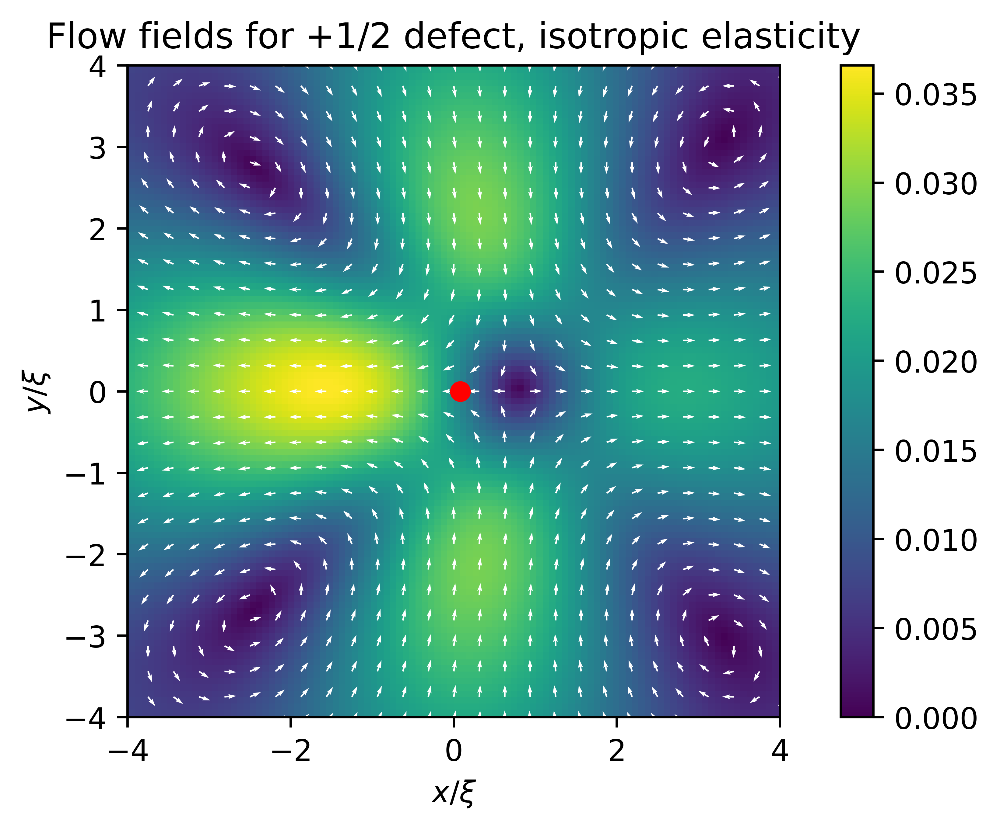

In [78]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (60, 60))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w', scale=55)
ax.set_title('Flow fields for +1/2 defect, isotropic elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-isotropic-elasticity-zoomed.png')
fig.savefig(filename_stress_tensor)

# Do $\epsilon < 0$ configurations

In [79]:
eta_filename = os.path.join(data_folder, "eta_negEps.csv")
eta = np.genfromtxt(eta_filename, delimiter=',')

mu_filename = os.path.join(data_folder, "mu_negEps.csv")
mu = np.genfromtxt(mu_filename, delimiter=',')

nu_filename = os.path.join(data_folder, "nu_negEps.csv")
nu = np.genfromtxt(nu_filename, delimiter=',')

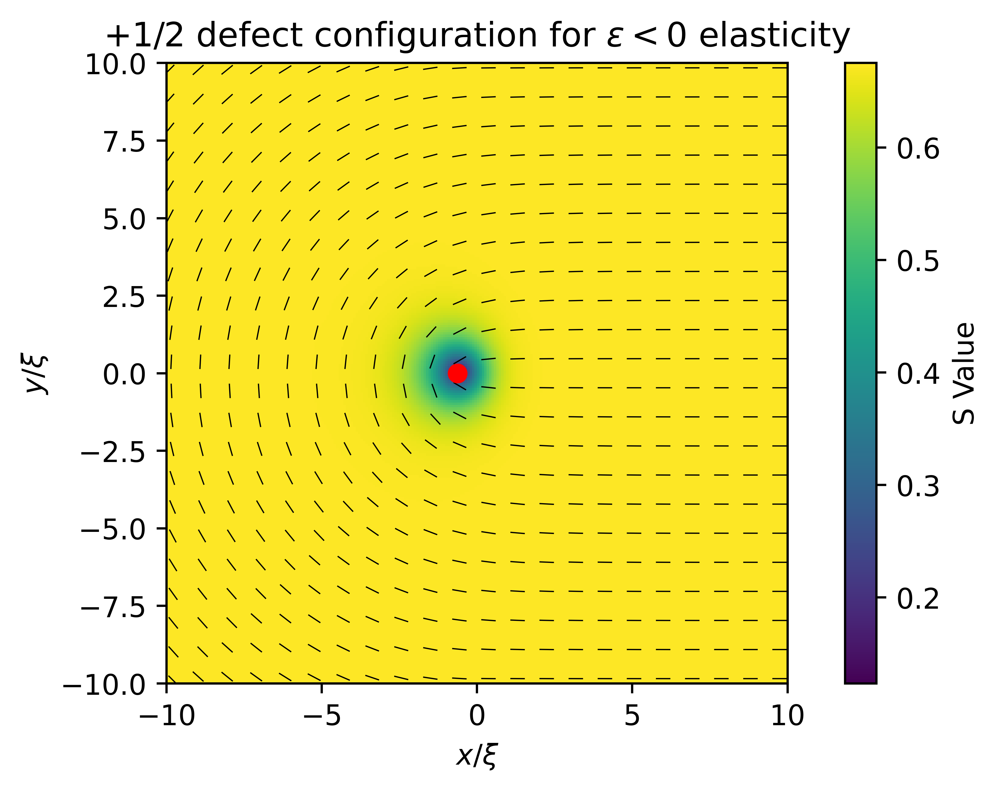

In [80]:
sparse_shape = (20, 20)
S_sparse_shape = (200, 200)
S_cutoff = 0.1

lambda_max = lch.calcQEigenvals(eta, mu, nu)
U, V = lch.calcQEigenvecs(eta, mu, nu, lambda_max, S_cutoff)

min_vals, min_x, min_y = lch.findDefects(lambda_max, X, Y, num_defects)

sparse_idx = lch.sparseIdx(eta.shape, sparse_shape)
S_sparse_idx = lch.sparseIdx(eta.shape, S_sparse_shape)

fig, ax = plt.subplots()
c = ax.pcolor(X[S_sparse_idx], Y[S_sparse_idx], (3/2)*lambda_max[S_sparse_idx])
q = ax.quiver(X[sparse_idx], Y[sparse_idx], U[sparse_idx], V[sparse_idx],
              headwidth=0, pivot='middle', headaxislength=5, scale=30, width=0.002)
ax.plot(min_x, min_y, marker='o', c='r')

fig.colorbar(c, ax=ax, label="S Value")
ax.set_title(r"+1/2 defect configuration for $\epsilon < 0$ elasticity")
ax.set_xlabel(r"$x/\xi$")
ax.set_ylabel(r"$y/\xi$")
ax.set_aspect('equal', 'box')
fig.tight_layout()

config_filename = os.path.join(save_folder, r'negEps-configuration.png')
fig.savefig(config_filename)

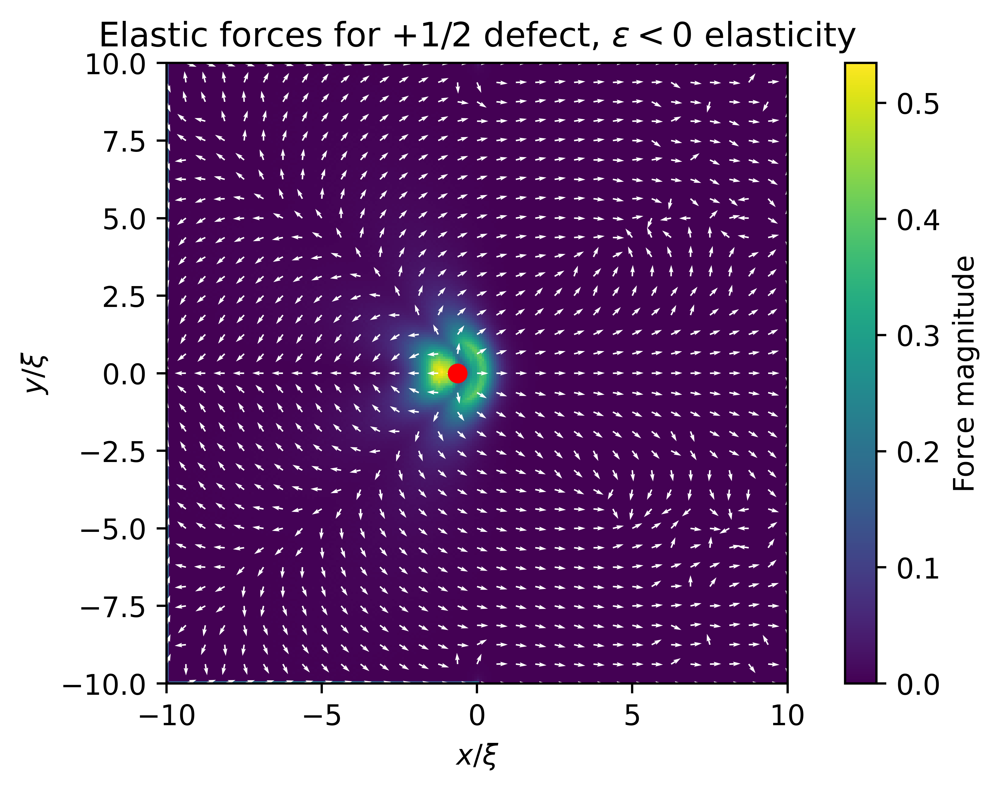

In [81]:
kappa_2 = 0
kappa_3 = -1

fL1_x, fL1_y = lch.fL1(eta, mu, nu, dx)
fL2_x, fL2_y = lch.fL2(eta, mu, nu, dx)
fL3_x, fL3_y = lch.fL3(eta, mu, nu, dx)

fe_x = fL1_x + kappa_2*fL2_x + kappa_3*fL3_x
fe_y = fL1_y + kappa_2*fL2_y + kappa_3*fL3_y

fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

sparse_idx = lch.sparseIdx(fe_x.shape, (30, 30))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm[sparse_idx], fe_y_norm[sparse_idx], pivot='tail', color='w', scale=55)
ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon < 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-negative-elasticity-unzoomed.png')
fig.savefig(filename_force_field)

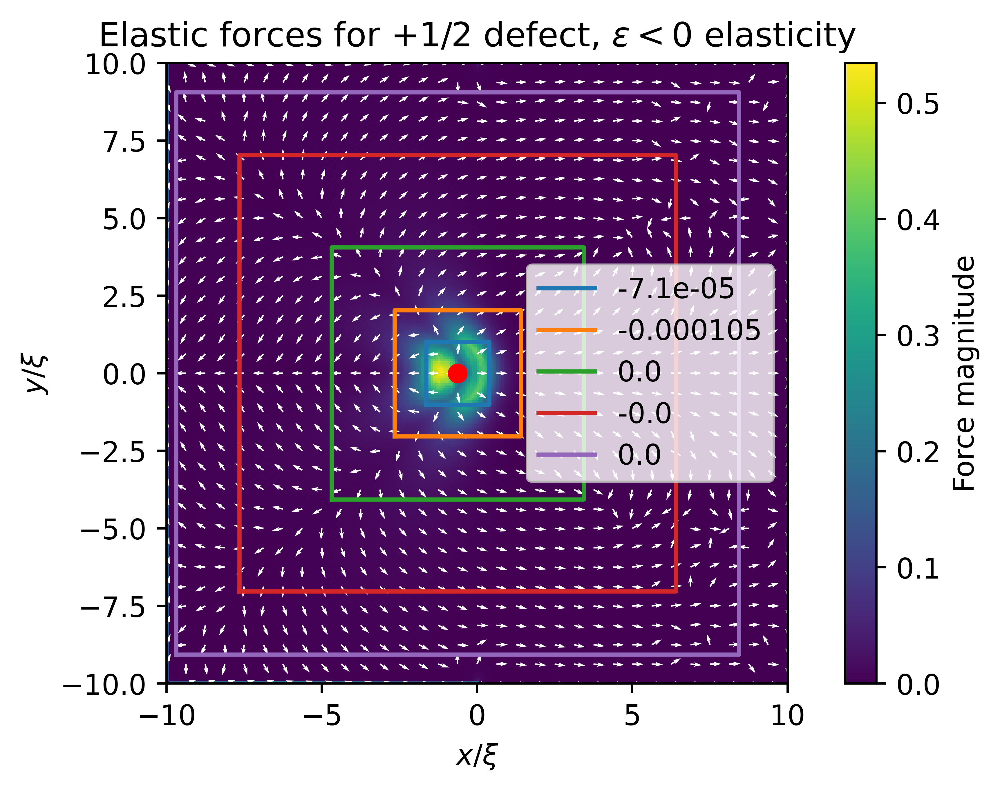

In [83]:
fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

sparse_idx = lch.sparseIdx(fe_x.shape, (30, 30))

fig, ax = plt.subplots()
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm[sparse_idx], fe_y_norm[sparse_idx], pivot='tail', color='w', scale=55)

r_array = [1, 2, 4, 7, 9]
ax.plot(min_x, min_y, marker='o', c='r')
for r in r_array:
    I, path_x, path_y = contourIntegral(fe_x, fe_y, dx, r, X, Y, min_x, min_y)
    norm_I = I/(4*r**2)
    ax.plot(path_x, path_y, label=norm_I.round(6))
ax.legend()

ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon < 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-negative-elasticity-contours.png')
fig.savefig(filename_force_field)

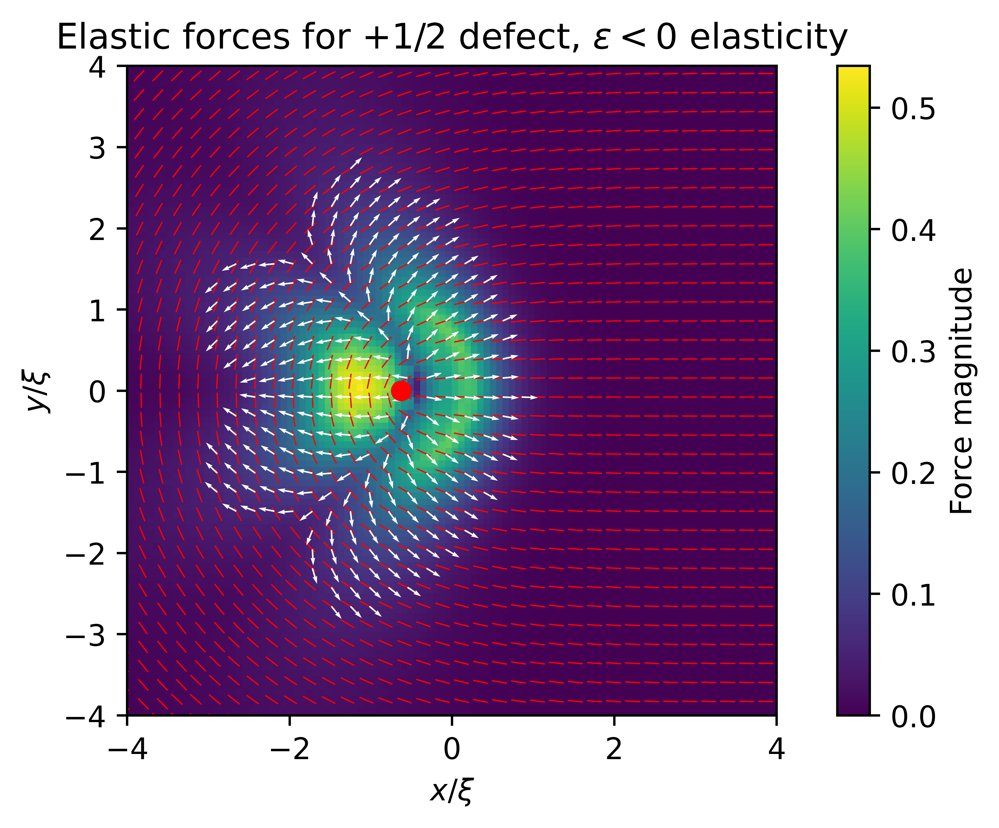

In [84]:
fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

mask2 = fe < 0.05
fe_x_norm_m = np.ma.masked_array(fe_x_norm, mask2)
fe_y_norm_m = np.ma.masked_array(fe_y_norm, mask2)

sparse_idx = lch.sparseIdx(fe_x.shape, (75, 75))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q1 = ax.quiver(X[sparse_idx], Y[sparse_idx], U[sparse_idx], V[sparse_idx],
               headwidth=0, pivot='middle', headaxislength=5, scale=30, width=0.002, color='r')
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm_m[sparse_idx], fe_y_norm_m[sparse_idx], pivot='tail', color='w', scale=40)
ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon < 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-negative-elasticity-nematic-overlayed.png')
fig.savefig(filename_force_field)

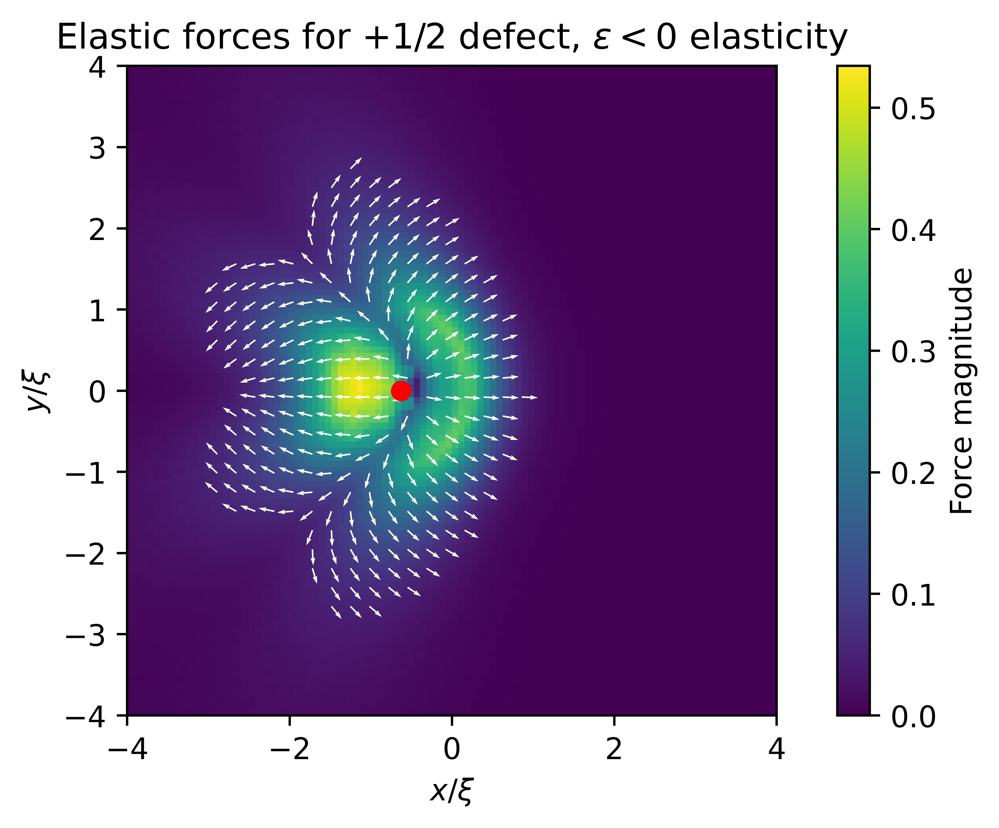

In [85]:
fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

mask2 = fe < 0.05
fe_x_norm_m = np.ma.masked_array(fe_x_norm, mask2)
fe_y_norm_m = np.ma.masked_array(fe_y_norm, mask2)

sparse_idx = lch.sparseIdx(fe_x.shape, (75, 75))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm_m[sparse_idx], fe_y_norm_m[sparse_idx], pivot='tail', color='w', scale=40)
ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon < 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-negative-elasticity.png')
fig.savefig(filename_force_field)

In [86]:
psi = np.zeros(eta.shape)
source_term = (4 / lch.b)*(lch.Phi_L1(eta, mu, nu, dx)
                           + kappa_2*lch.Phi_L2(eta, mu, nu, dx)
                           + kappa_3*lch.Phi_L3(eta, mu, nu, dx)
                           )
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

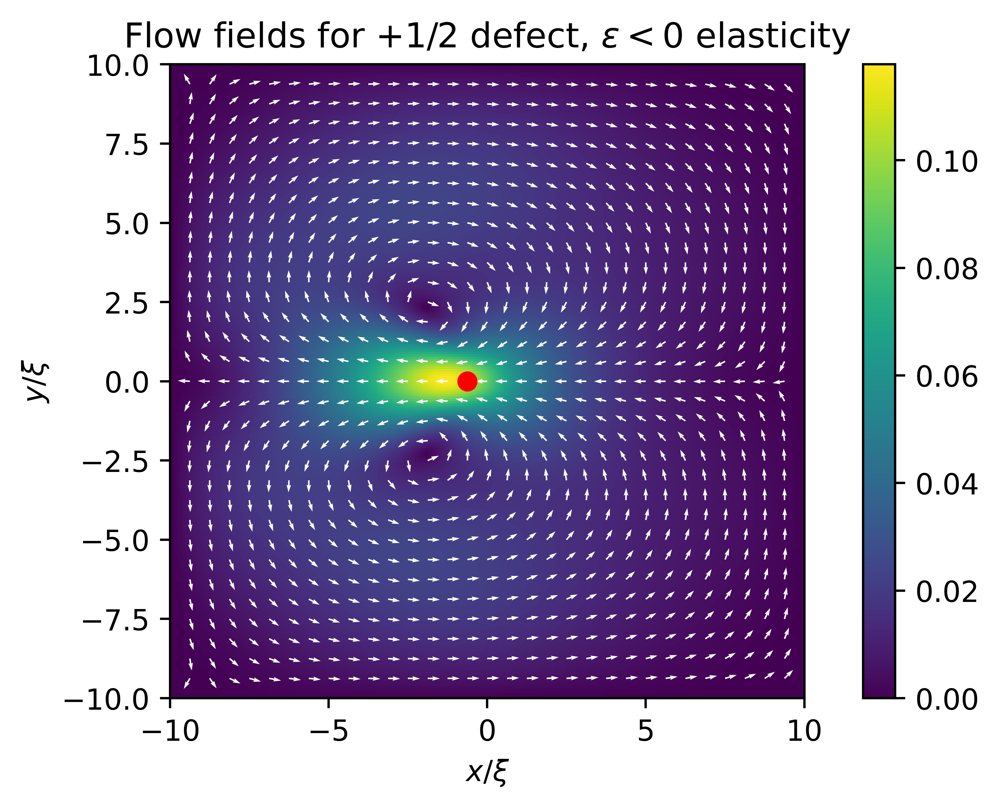

In [87]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (30, 30))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title(r'Flow fields for +1/2 defect, $\epsilon < 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-negative-epsilon-elasticity.png')
fig.savefig(filename_stress_tensor)

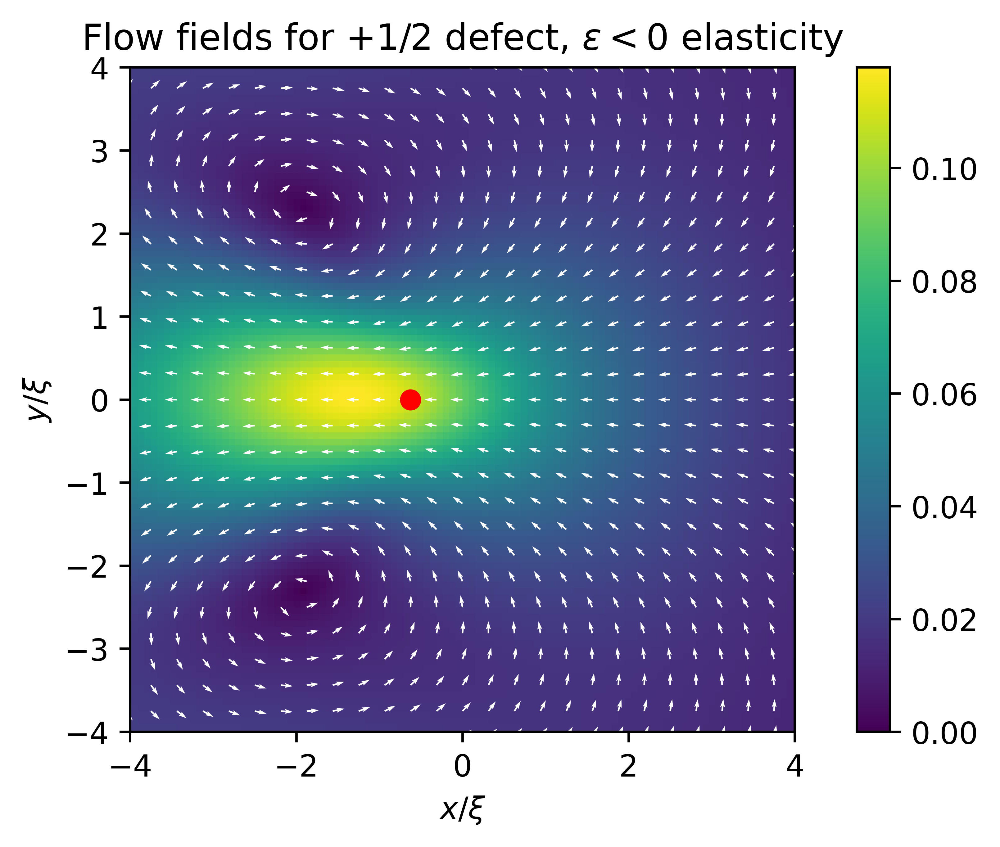

In [88]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (60, 60))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w', scale=55)
ax.set_title(r'Flow fields for +1/2 defect, $\epsilon < 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-negative-epsilon-elasticity-zoomed.png')
fig.savefig(filename_stress_tensor)

# Do $\epsilon > 0$ configurations

In [89]:
eta_filename = os.path.join(data_folder, "eta_posEps.csv")
eta = np.genfromtxt(eta_filename, delimiter=',')

mu_filename = os.path.join(data_folder, "mu_posEps.csv")
mu = np.genfromtxt(mu_filename, delimiter=',')

nu_filename = os.path.join(data_folder, "nu_posEps.csv")
nu = np.genfromtxt(nu_filename, delimiter=',')

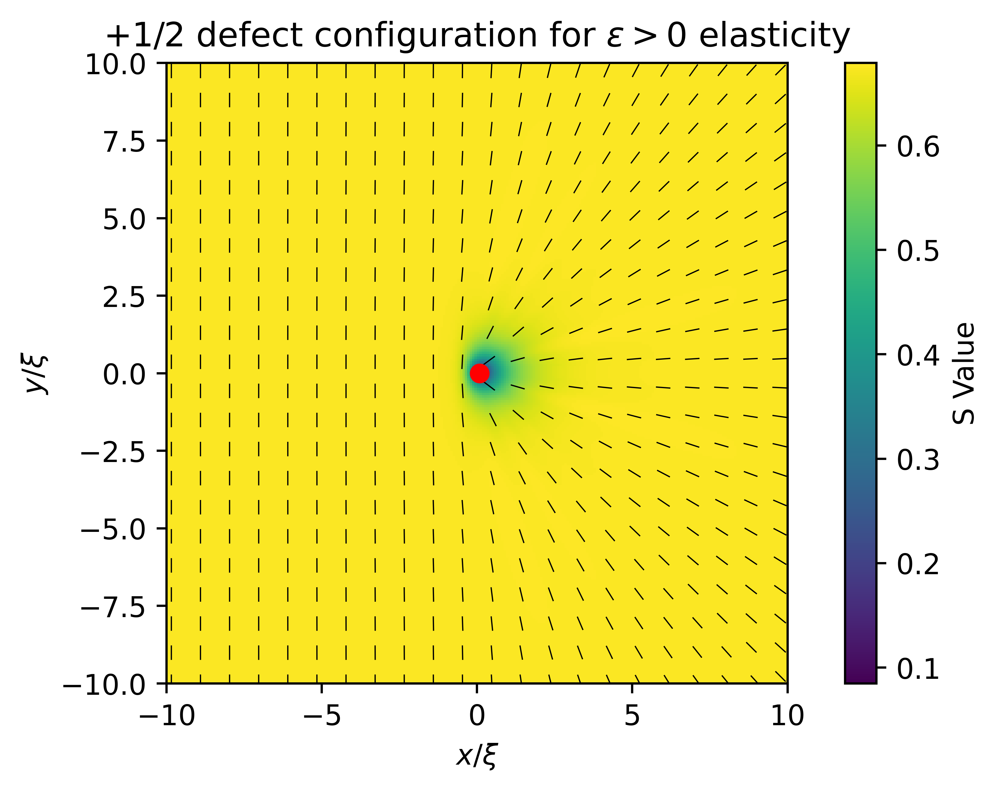

In [90]:
sparse_shape = (20, 20)
S_sparse_shape = (200, 200)
S_cutoff = 0.1

lambda_max = lch.calcQEigenvals(eta, mu, nu)
U, V = lch.calcQEigenvecs(eta, mu, nu, lambda_max, S_cutoff)

min_vals, min_x, min_y = lch.findDefects(lambda_max, X, Y, num_defects)

sparse_idx = lch.sparseIdx(eta.shape, sparse_shape)
S_sparse_idx = lch.sparseIdx(eta.shape, S_sparse_shape)

fig, ax = plt.subplots()
c = ax.pcolor(X[S_sparse_idx], Y[S_sparse_idx], (3/2)*lambda_max[S_sparse_idx])
q = ax.quiver(X[sparse_idx], Y[sparse_idx], U[sparse_idx], V[sparse_idx],
              headwidth=0, pivot='middle', headaxislength=5, scale=30, width=0.002)

ax.plot(min_x, min_y, marker='o', c='r')

ax.axis('equal')
fig.colorbar(c, ax=ax, label="S Value")
ax.set_title(r"+1/2 defect configuration for $\epsilon > 0$ elasticity")
ax.set_xlabel(r"$x/\xi$")
ax.set_ylabel(r"$y/\xi$")
ax.set_aspect('equal', 'box')
fig.tight_layout()

config_filename = os.path.join(save_folder, r'posEps-configuration.png')
fig.savefig(config_filename)

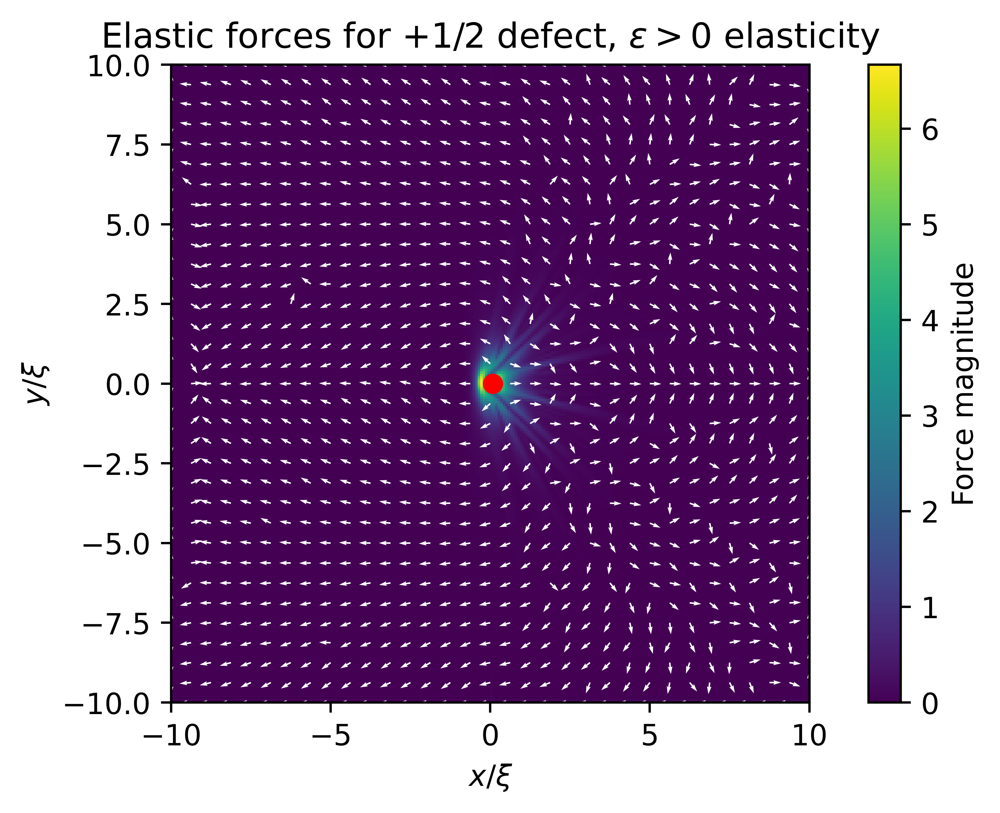

In [91]:
kappa_2 = 0
kappa_3 = 4

fL1_x, fL1_y = lch.fL1(eta, mu, nu, dx)
fL2_x, fL2_y = lch.fL2(eta, mu, nu, dx)
fL3_x, fL3_y = lch.fL3(eta, mu, nu, dx)

fe_x = fL1_x + kappa_2*fL2_x + kappa_3*fL3_x
fe_y = fL1_y + kappa_2*fL2_y + kappa_3*fL3_y

fe_x, fe_y = lch.fL1(eta, mu, nu, dx, dy=None)

fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

sparse_idx = lch.sparseIdx(fe_x.shape, (30, 30))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm[sparse_idx], fe_y_norm[sparse_idx], pivot='tail', color='w', scale=55)
ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon > 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-positive-elasticity-unzoomed.png')
fig.savefig(filename_force_field)

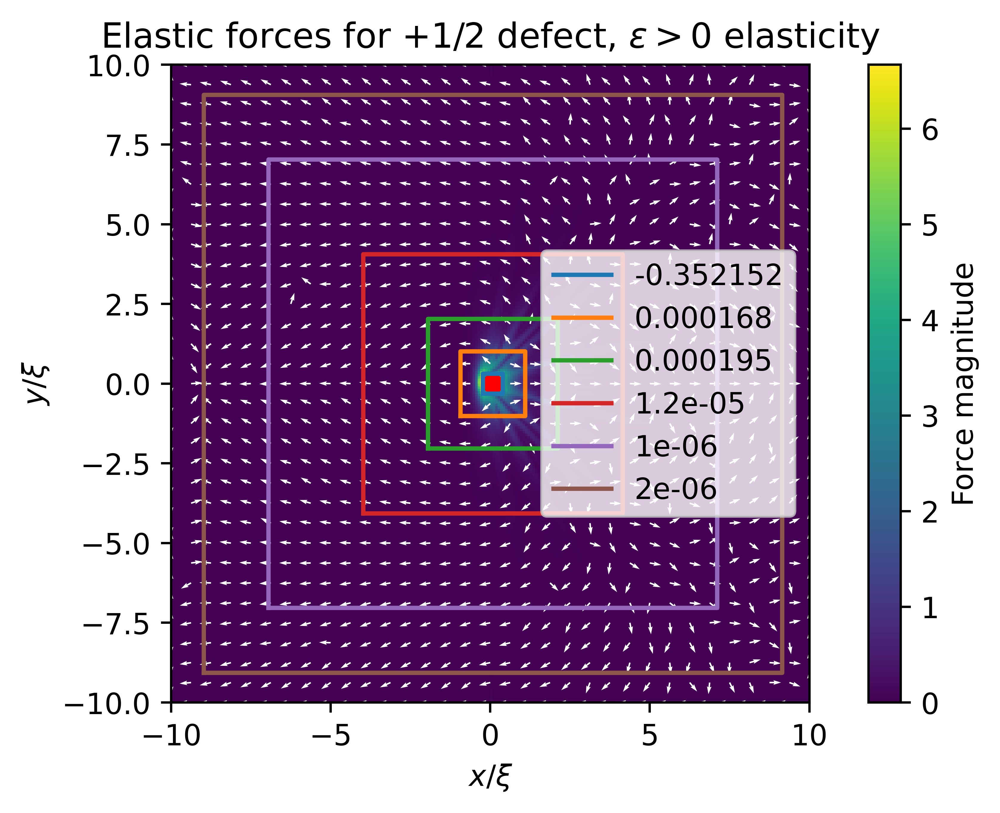

In [92]:
fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

sparse_idx = lch.sparseIdx(fe_x.shape, (30, 30))

fig, ax = plt.subplots()
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm[sparse_idx], fe_y_norm[sparse_idx], pivot='tail', color='w', scale=55)

r_array = [0.25, 1, 2, 4, 7, 9]
ax.plot(min_x, min_y, marker='o', c='r')
for r in r_array:
    I, path_x, path_y = contourIntegral(fe_x, fe_y, dx, r, X, Y, min_x, min_y)
    norm_I = I/(4*r**2)
    ax.plot(path_x, path_y, label=norm_I.round(6))
ax.legend()

ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon > 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-positive-elasticity-unzoomed.png')
fig.savefig(filename_force_field)

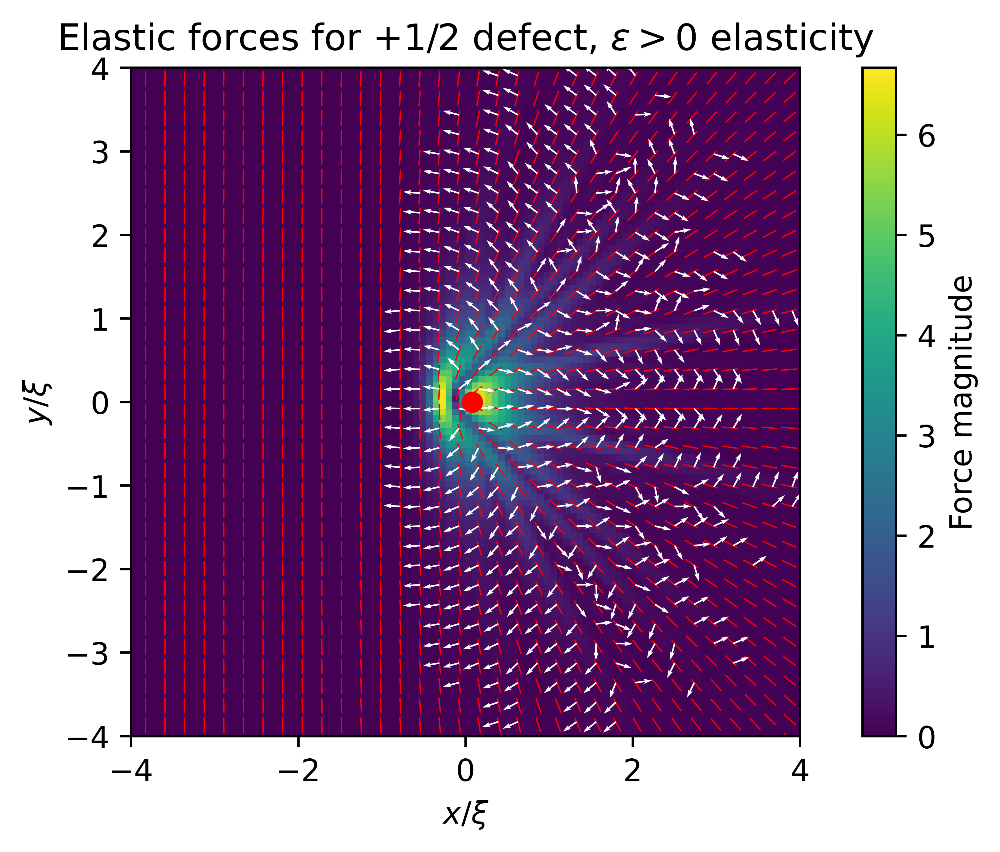

In [93]:
fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

mask2 = fe < 0.05
fe_x_norm_m = np.ma.masked_array(fe_x_norm, mask2)
fe_y_norm_m = np.ma.masked_array(fe_y_norm, mask2)

sparse_idx = lch.sparseIdx(fe_x.shape, (75, 75))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q1 = ax.quiver(X[sparse_idx], Y[sparse_idx], U[sparse_idx], V[sparse_idx],
               headwidth=0, pivot='middle', headaxislength=5, scale=30, width=0.002, color='r')
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm_m[sparse_idx], fe_y_norm_m[sparse_idx], pivot='tail', color='w', scale=40)
ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon > 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-positive-elasticity-nematic-overlayed.png')
fig.savefig(filename_force_field)

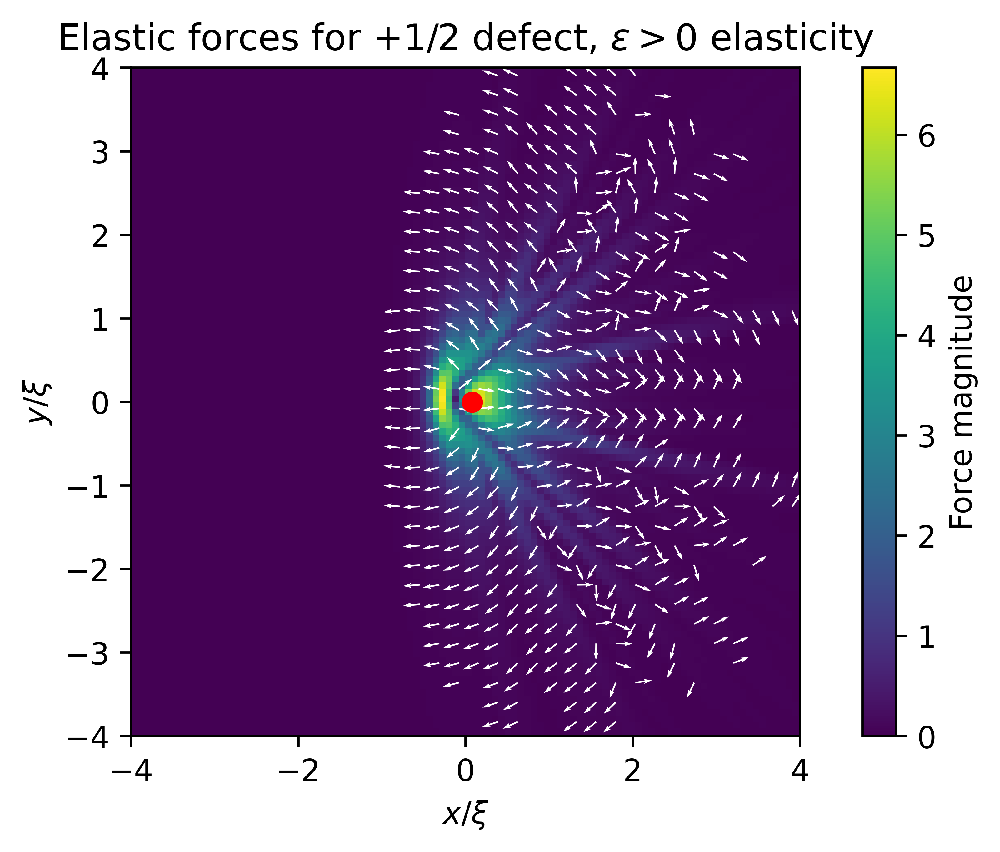

In [94]:
fe = np.sqrt(fe_x**2 + fe_y**2)

mask = np.where(fe != 0)
fe_x_norm = np.zeros(fe_x.shape)
fe_y_norm = np.zeros(fe_y.shape)
fe_x_norm[mask] = fe_x[mask]/fe[mask]
fe_y_norm[mask] = fe_y[mask]/fe[mask]

mask2 = fe < 0.05
fe_x_norm_m = np.ma.masked_array(fe_x_norm, mask2)
fe_y_norm_m = np.ma.masked_array(fe_y_norm, mask2)

sparse_idx = lch.sparseIdx(fe_x.shape, (75, 75))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, fe)
fig.colorbar(c, ax=ax, label="Force magnitude")
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              fe_x_norm_m[sparse_idx], fe_y_norm_m[sparse_idx], pivot='tail', color='w', scale=40)
ax.set_title(r'Elastic forces for +1/2 defect, $\epsilon > 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_force_field = os.path.join(save_folder, r'force-field-1_2-defect-epsilon-positive-elasticity.png')
fig.savefig(filename_force_field)

In [104]:
psi = np.zeros(eta.shape)
source_term = (4/lch.b)*(lch.Phi_L1(eta, mu, nu, dx)
                         + kappa_2*lch.Phi_L2(eta, mu, nu, dx)
                         + kappa_3*lch.Phi_L3(eta, mu, nu, dx)
                         )
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

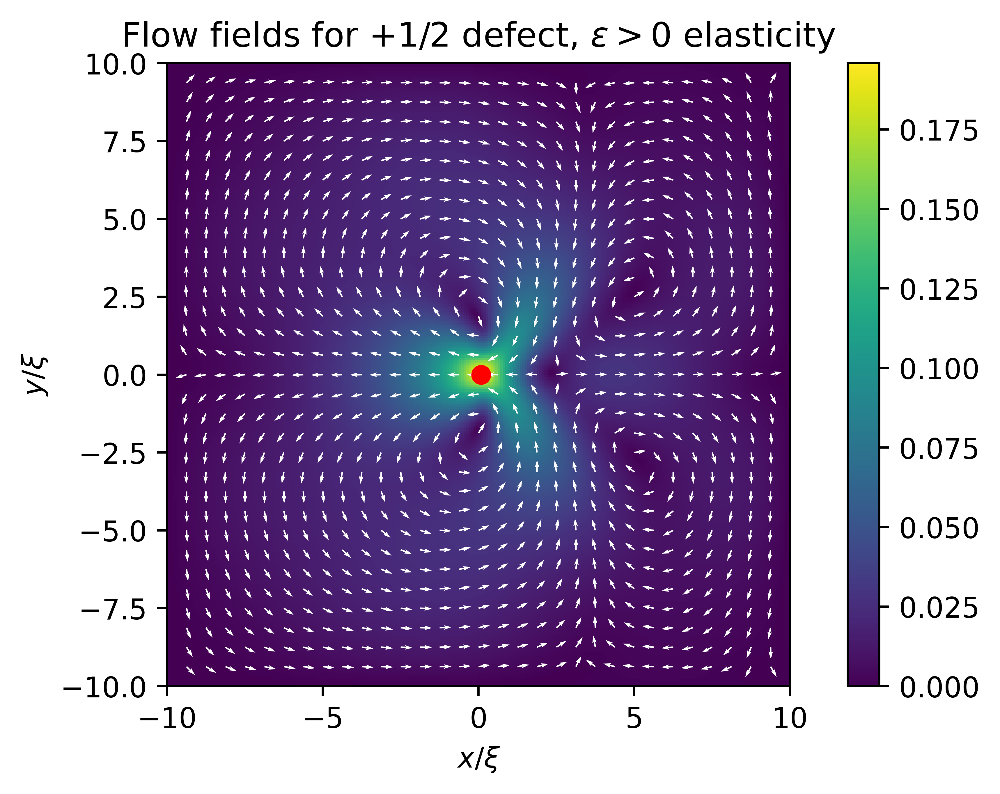

In [105]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (30, 30))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title(r'Flow fields for +1/2 defect, $\epsilon > 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-positive-epsilon-elasticity.png')
fig.savefig(filename_stress_tensor)

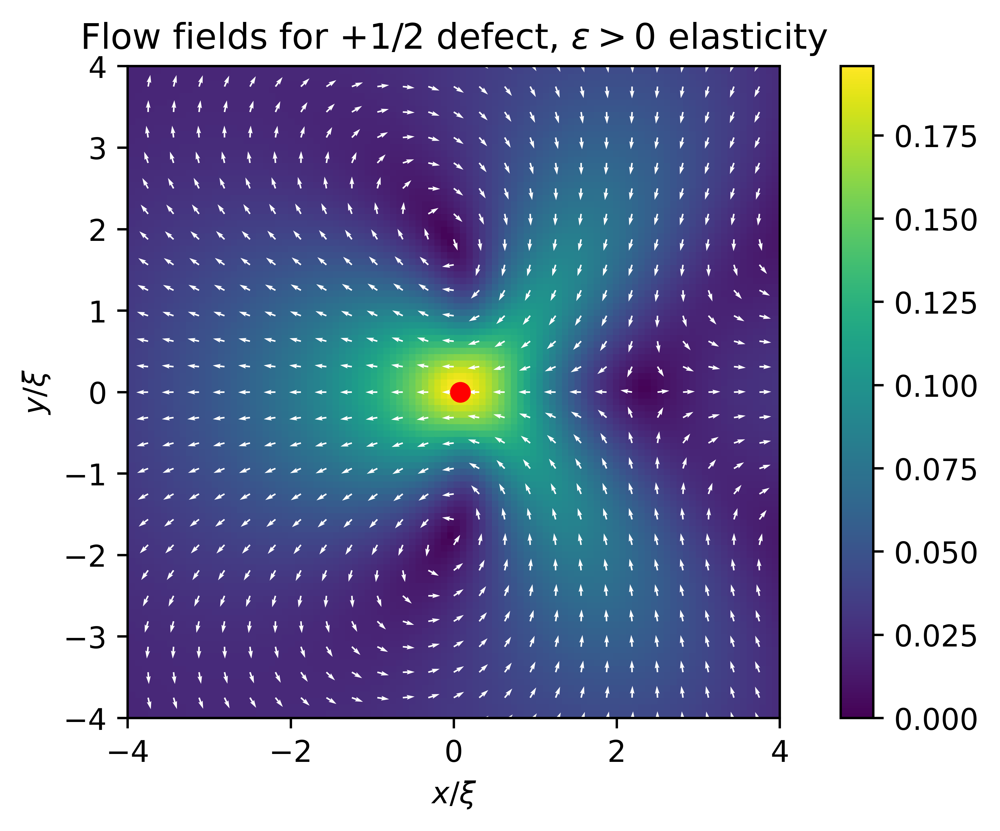

In [97]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (60, 60))

fig, ax = plt.subplots()
ax.plot(min_x, min_y, marker='o', c='r')
ax.set_xlim(-4, 4)
ax.set_ylim(-4, 4)
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w', scale=55)
ax.set_title(r'Flow fields for +1/2 defect, $\epsilon > 0$ elasticity')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')
ax.set_aspect('equal', 'box')
fig.tight_layout()

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-positive-epsilon-elasticity-zoomed.png')
fig.savefig(filename_stress_tensor)

# Try with active nematic stress tensor

In [70]:
def f_a(eta, mu, nu, dx):
    return fd.dx2_dy2(nu, dx) + fd.dxdy(mu, dx) - fd.dxdy(eta, dx)

In [72]:
zeta = 1

## Isotropic case

In [69]:
eta_filename = os.path.join(data_folder, "eta_Iso.csv")
eta = np.genfromtxt(eta_filename, delimiter=',')

mu_filename = os.path.join(data_folder, "mu_Iso.csv")
mu = np.genfromtxt(mu_filename, delimiter=',')

nu_filename = os.path.join(data_folder, "nu_Iso.csv")
nu = np.genfromtxt(nu_filename, delimiter=',')

In [73]:
psi = np.zeros(eta.shape)
source_term = zeta*f_a(eta, mu, nu, dx)
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

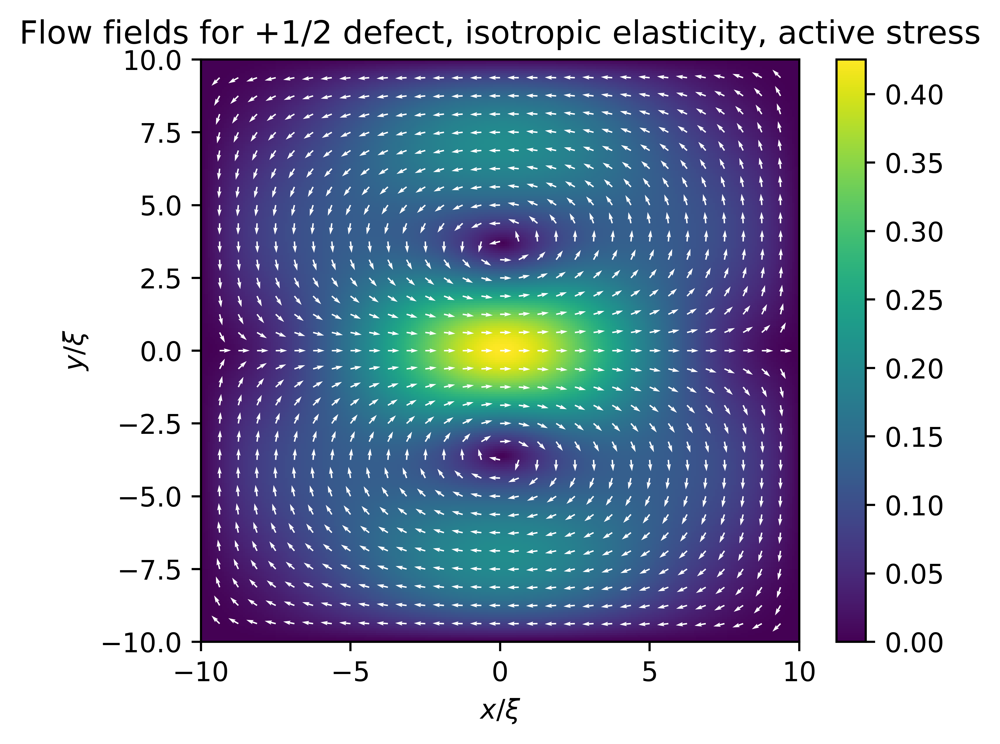

In [74]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (30, 30))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title('Flow fields for +1/2 defect, isotropic elasticity, active stress')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-isotropic-active-stress.png')
fig.savefig(filename_stress_tensor)

## $\epsilon < 0$ configuration

In [75]:
eta_filename = os.path.join(data_folder, "eta_negEps.csv")
eta = np.genfromtxt(eta_filename, delimiter=',')

mu_filename = os.path.join(data_folder, "mu_negEps.csv")
mu = np.genfromtxt(mu_filename, delimiter=',')

nu_filename = os.path.join(data_folder, "nu_negEps.csv")
nu = np.genfromtxt(nu_filename, delimiter=',')

In [76]:
psi = np.zeros(eta.shape)
source_term = zeta*f_a(eta, mu, nu, dx)
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

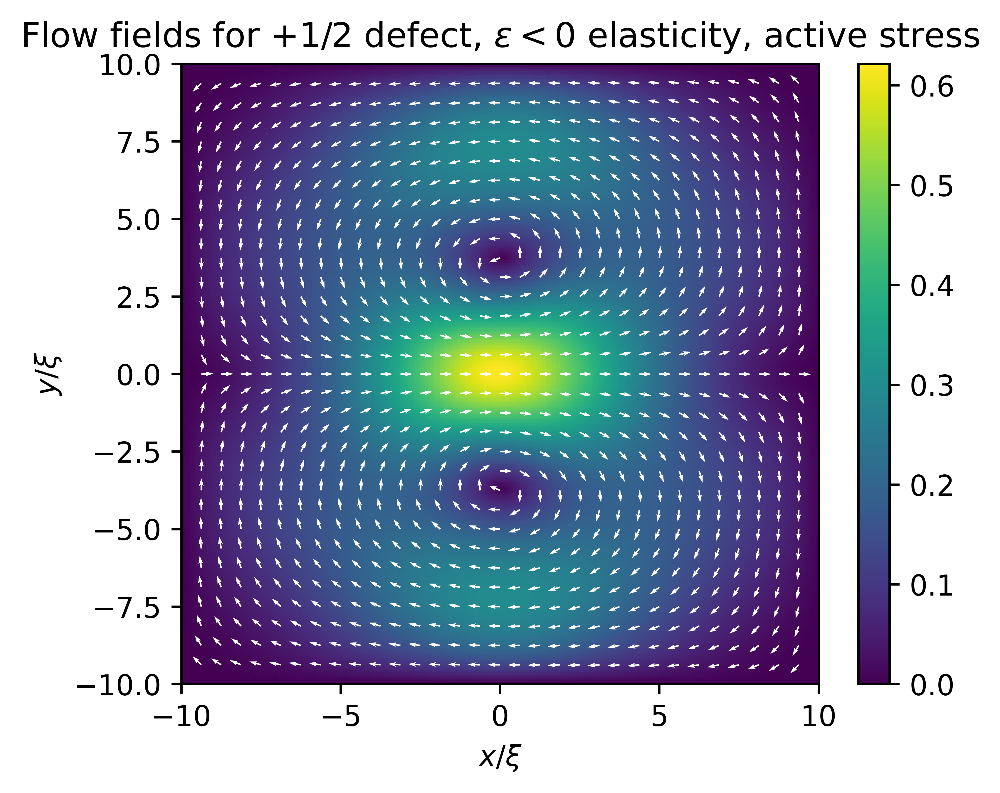

In [77]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (30, 30))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title(r'Flow fields for +1/2 defect, $\epsilon < 0$ elasticity, active stress')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-negative-epsilon-active-stress.png')
fig.savefig(filename_stress_tensor)

# $\epsilon > 0$ configuration

In [78]:
eta_filename = os.path.join(data_folder, "eta_posEps.csv")
eta = np.genfromtxt(eta_filename, delimiter=',')

mu_filename = os.path.join(data_folder, "mu_posEps.csv")
mu = np.genfromtxt(mu_filename, delimiter=',')

nu_filename = os.path.join(data_folder, "nu_posEps.csv")
nu = np.genfromtxt(nu_filename, delimiter=',')

In [79]:
psi = np.zeros(eta.shape)
source_term = zeta*f_a(eta, mu, nu, dx)
psi[1:-1, 1:-1], info, calls = bh_solver.solve(source_term[1:-1, 1:-1])

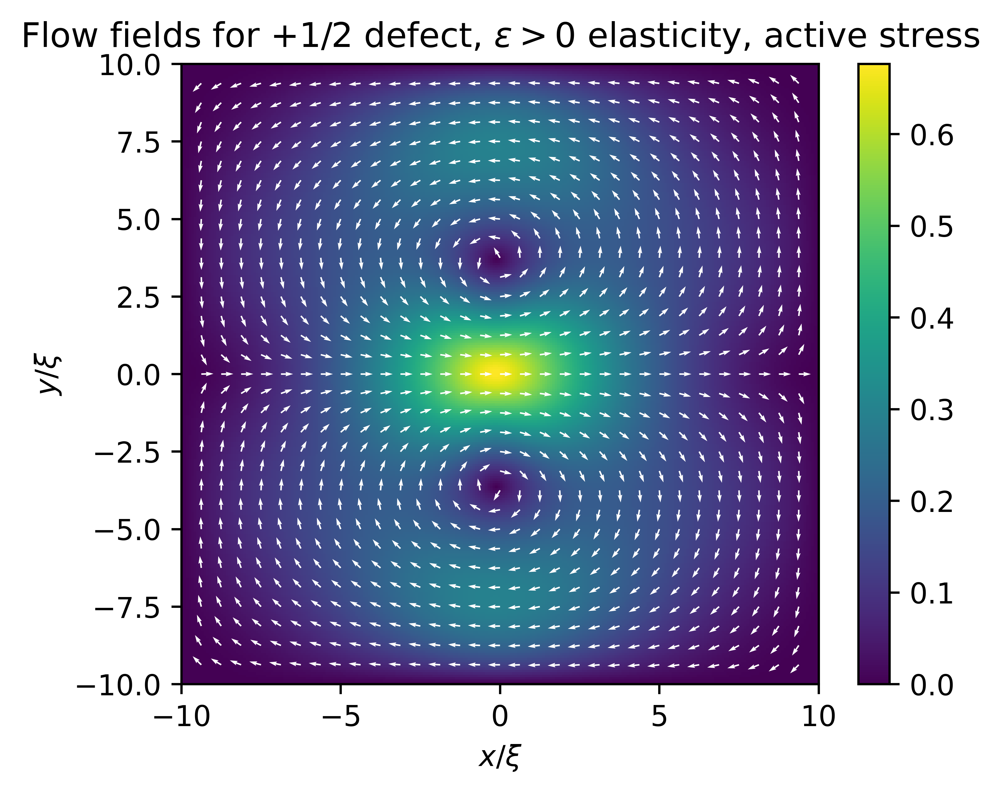

In [80]:
vx, vy = fd.curl(psi, dx)
v = np.sqrt(vx**2 + vy**2)

mask = np.where(v != 0)
vx_norm = np.zeros(vx.shape)
vy_norm = np.zeros(vy.shape)
vx_norm[mask] = vx[mask]/v[mask]
vy_norm[mask] = vy[mask]/v[mask]

sparse_idx = lch.sparseIdx(vx.shape, (30, 30))

fig, ax = plt.subplots(figsize=(5, 4))
c = ax.pcolor(X, Y, v)
fig.colorbar(c, ax=ax)
q = ax.quiver(X[sparse_idx], Y[sparse_idx],
              vx_norm[sparse_idx], vy_norm[sparse_idx], pivot='tail', color='w')
ax.set_title(r'Flow fields for +1/2 defect, $\epsilon > 0$ elasticity, active stress')
ax.set_xlabel(r'$x/\xi$')
ax.set_ylabel(r'$y/\xi$')

filename_stress_tensor = os.path.join(save_folder, r'flow-field-1_2-defect-positive-epsilon-active-stress.png')
fig.savefig(filename_stress_tensor)